**Analysis of top30-likelihood genes in velocity.**

Where does the GRN agree in direction?
Where does it disagree?

In [1]:
import os
import sys

import matplotlib.colors as colors
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import scvelo as scv
from scipy import stats
from scipy.sparse import csr_matrix

import celloracle as co

In [2]:
%matplotlib inline

In [3]:
from matplotlib import rcParams
rcParams.update({'figure.autolayout': True})

In [4]:
scv.settings.verbosity = 3  # show errors(0), warnings(1), info(2), hints(3)
scv.settings.presenter_view = True  # set max width size for presenter view
scv.set_figure_params('scvelo')  # for beautified visualization

## 0. Load GRN info

In [5]:
# Load file with GRN info
oracle = co.load_hdf5("./Pancreas_grn_sim.celloracle.oracle")

In [6]:
#rename so we do not overwrite the info
oracle.adata.var['grn_score'] = oracle.adata.var['velocity_score'].copy()
oracle.adata.uns['rank_grn_genes'] = oracle.adata.uns['rank_velocity_genes'].copy()

## 1. Estimate velocities

In [7]:
scv.tl.recover_dynamics(oracle.adata, n_jobs = 10)

recovering dynamics (using 10/16 cores)


  0%|          | 0/1298 [00:00<?, ?gene/s]

    finished (0:02:03) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)


In [8]:
#compute velocities
scv.tl.velocity(oracle.adata, mode='dynamical')

computing velocities
    finished (0:00:02) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)


In [9]:
scv.tl.velocity_graph(oracle.adata)

computing velocity graph
    finished (0:00:05) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


In [10]:
#scv.pl.velocity_embedding_stream(oracle.adata, basis='umap')

## 2. Latent time

In [11]:
scv.tl.latent_time(oracle.adata)
#scv.pl.scatter(oracle.adata, color='latent_time', color_map='gnuplot', size=80)

computing terminal states
    identified 2 regions of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
computing latent time using root_cells as prior
    finished (0:00:00) --> added 
    'latent_time', shared time (adata.obs)


In [12]:
top_genes = oracle.adata.var['fit_likelihood'].sort_values(ascending=False).index#[:300]
#scv.pl.heatmap(oracle.adata, var_names=top_genes, sortby='latent_time', col_color='clusters', n_convolve=100)

In [13]:
scv.tl.rank_dynamical_genes(oracle.adata, groupby='clusters')

ranking genes by cluster-specific likelihoods
    finished (0:00:02) --> added 
    'rank_dynamical_genes', sorted scores by group ids (adata.uns)


In [14]:
# Save oracle object.
oracle.to_hdf5("Pancreas_grn_vel.celloracle.oracle")

## 3. Top-likelihood genes

We will compare the results that we got from the grn with the results from the velocity in the top 30 likelihood genes.

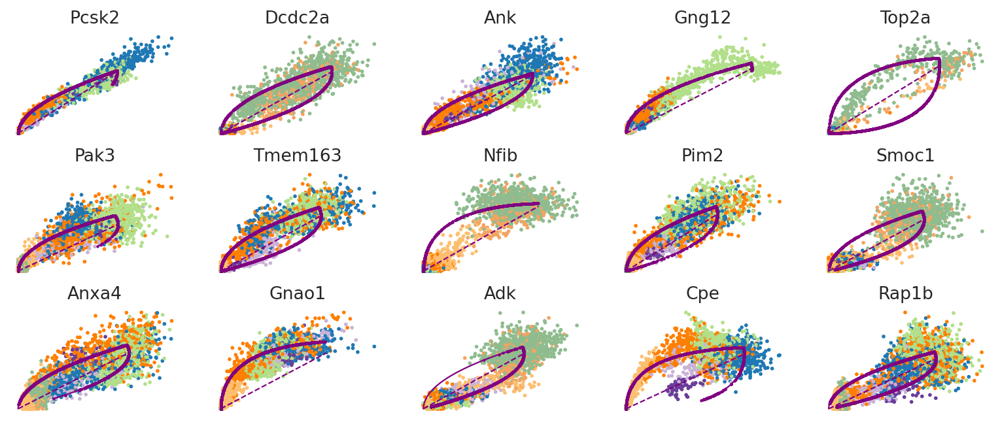

In [15]:
scv.pl.scatter(oracle.adata, basis=top_genes[:15], ncols=5, frameon=False)

In [16]:
#save these 30 likelihood genes
top30 = oracle.adata[:,list(top_genes[:30])]

We'll take a look at which genes are consistent and which ones are inconsistent between the 2 approaches.
GRN and velocity go to the same direction or opposite?

In [17]:
pearson = []
spearman = []

for i in np.arange(30):
    pearson.append(np.corrcoef((top30.layers['grn'].T)[i], (top30.layers['velocity'].T)[i])[0][1])
    spearman.append(stats.spearmanr((top30.layers['grn'].T)[i],(top30.layers['velocity'].T)[i])[0])

pearson = np.asarray(pearson)
spearman = np.asarray(spearman)

In [20]:
top30_corr = pd.DataFrame()
top30_corr['gene'], top30_corr['pearson'], top30_corr['spearman'] = list(top_genes[:30]), pearson , spearman

<AxesSubplot:>

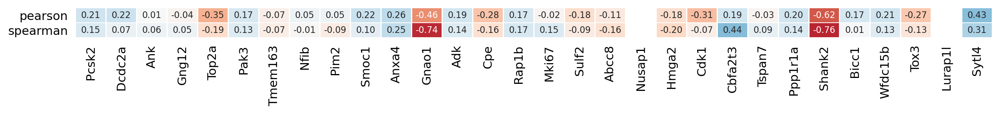

In [19]:
#Correlations
plt.figure(figsize=(15, 0.5))
sns.heatmap(np.asarray(top30_corr[['pearson', 'spearman']]).T.reshape(2,30), 
            xticklabels = np.asarray(top30_corr[['gene']]).reshape(30,), 
            yticklabels = ['pearson', 'spearman'],
            linewidths=.5,
            annot = True,
            fmt=".2f",
            annot_kws={'fontsize':8},
            cbar=False,
            cmap = "RdBu",
            vmin=-1, vmax=1)
#plt.savefig("./figures/top30_corr.png", dpi=150)

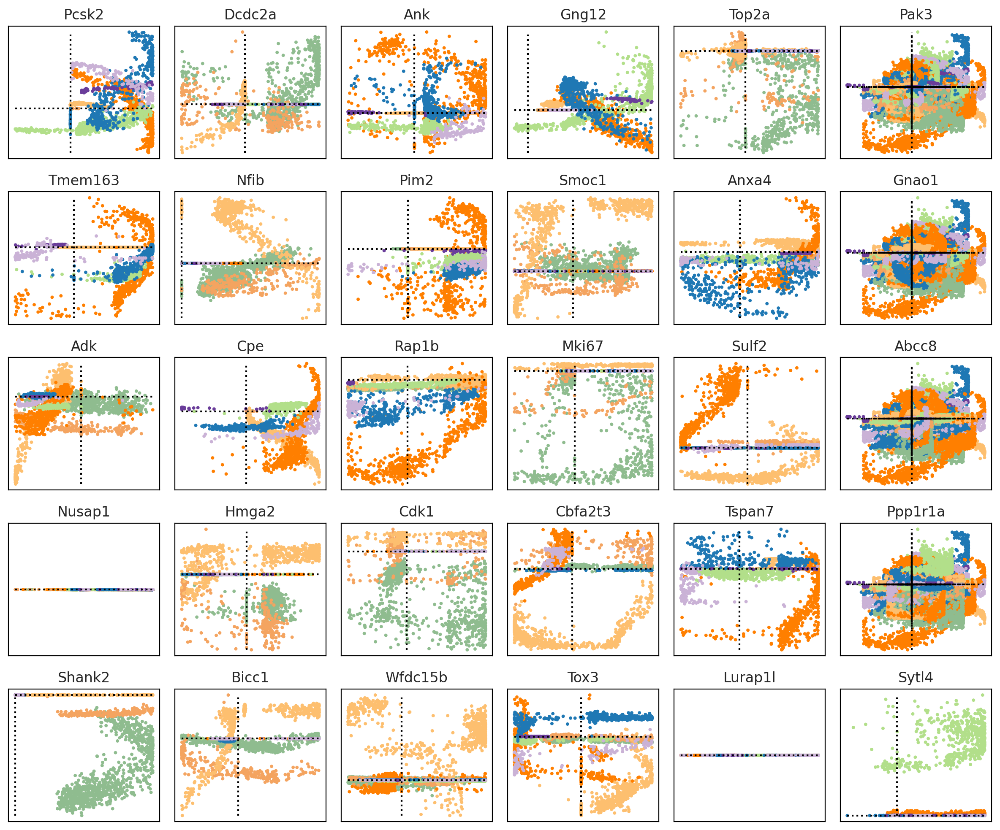

In [34]:
rows = 5
columns = 6 
fig, axs = plt.subplots(rows, columns, figsize=(columns*2,rows*2),constrained_layout=True)

for n in np.arange(rows):
    for i, var in enumerate(top30.var.index):
        if (i < (n+1)*columns) & (i >= n*columns):
            j=n
            k=i-(n*columns)
        sc.pl.scatter(top30, x=var, y=var, layers=('velocity','grn','velocity'), color='clusters',show=False, ax=axs[j,k])
        min_vel, max_vel = min((top30.layers['velocity'].T)[i]), max((top30.layers['velocity'].T)[i])
        min_grn, max_grn = min((top30.layers['grn'].T)[i]), max((top30.layers['grn'].T)[i])
        axs[j,k].plot([0,0],[min_grn,max_grn], 'k:')
        axs[j,k].plot([min_vel,max_vel],[0,0], 'k:')
        axs[j,k].set_title(var)
        axs[j,k].set_xlabel('')
        axs[j,k].set_ylabel('')
        axs[j,k].get_legend().remove()
        axs[j,k].get_xaxis().set_ticks([])
        axs[j,k].get_yaxis().set_ticks([])
        
        #axs[j,k].axis('off')
plt.savefig("./figures/top30_grn_vel.png", dpi=150)

Now I'll take a look at the 3 identified groups:
1. Genes with no information
2. Genes that are inconsistent
3. Genes that are consistent

### 3.1 Genes with no information

They are not transcription factors nor targets associated to any of them. Information is missing. </br>
Maybe we could think about SCENIC's approach, were we used only a list of TFs as regressors and then the ranking databases for prunning.

Trying to set attribute `.layers` of view, copying.


saving figure to file ./figures/scvelo_absent_velocity.png


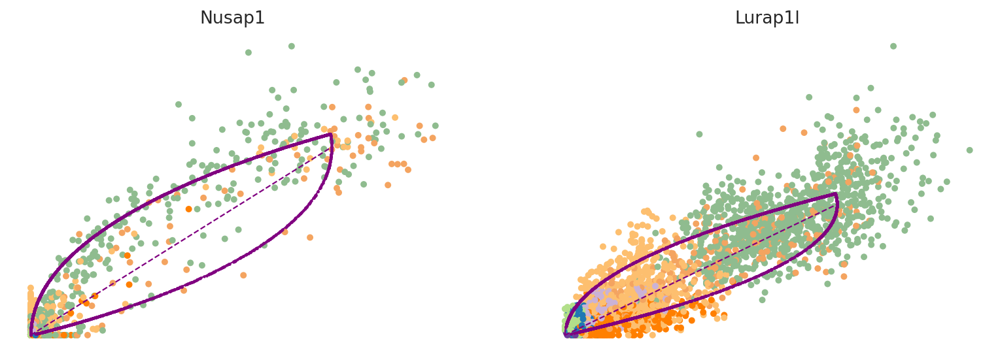

saving figure to file ./figures/scvelo_absent_time.png


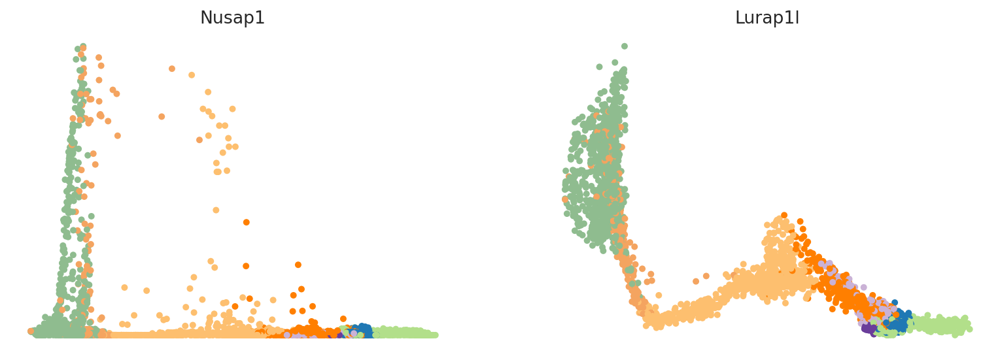

In [35]:
#We can see that these genes are dynamic
var_names = ['Nusap1', 'Lurap1l']
scv.pl.scatter(top30, var_names, frameon=False, size= 80, dpi = 150, save='absent_velocity.png')
scv.pl.scatter(top30, x='latent_time', y=var_names, frameon=False, size= 80, dpi=150, save='absent_time.png')

In [36]:
#data frame with the velocities of the top30 likelihood genes
top30_vel_df = pd.DataFrame(top30.layers['velocity'])
top30_vel_df.columns = np.asarray(top30.var.index)
top30_vel_df['cluster'] = np.asarray(top30.obs['clusters'])
top30_vel_df.head()

,Pcsk2,Dcdc2a,Ank,Gng12,Top2a,Pak3,Tmem163,Nfib,Pim2,Smoc1,...,Cbfa2t3,Tspan7,Ppp1r1a,Shank2,Bicc1,Wfdc15b,Tox3,Lurap1l,Sytl4,cluster
0,1.203516,-0.079694,0.290264,0.523420,-0.058277,0.182395,0.224112,0.000000,0.228801,-0.066766,...,-0.061478,0.394896,0.773522,0.000000,-0.197991,-0.087237,-0.538321,-0.121613,0.088744,Pre-endocrine
1,0.001838,0.163419,0.430770,0.107878,0.330124,0.040183,0.237062,0.059343,0.546700,0.098818,...,0.504194,0.492194,0.007367,0.033733,0.174533,-0.055782,0.002489,-0.188922,0.041541,Ductal
2,1.125103,-0.041489,-0.306211,0.320194,-0.000000,0.221916,0.176007,0.015609,0.569758,-0.116363,...,-0.065704,-0.378496,0.160690,0.000000,-0.121717,0.270049,-0.562575,-0.112193,0.425526,Alpha
3,0.000000,0.436701,-0.032245,0.081866,0.538652,0.028689,0.004379,0.088563,0.031713,0.109039,...,-0.014266,0.179846,0.007873,0.051212,-0.416115,-0.187813,-0.341082,0.500181,-0.029788,Ductal
4,0.493762,-0.009498,0.098838,0.249810,-0.033556,0.207856,0.168435,0.046944,0.352551,0.171773,...,-0.509239,0.605948,0.036218,0.000000,-0.045935,-0.059165,0.000000,-0.320760,-0.026155,Ngn3 high EP


In [37]:
sns.set_theme(style="whitegrid")
colors = top30.uns['clusters_colors']
order = ['Ductal','Ngn3 low EP', 'Ngn3 high EP', 'Pre-endocrine', 'Beta', 'Alpha', 'Delta', 'Epsilon']

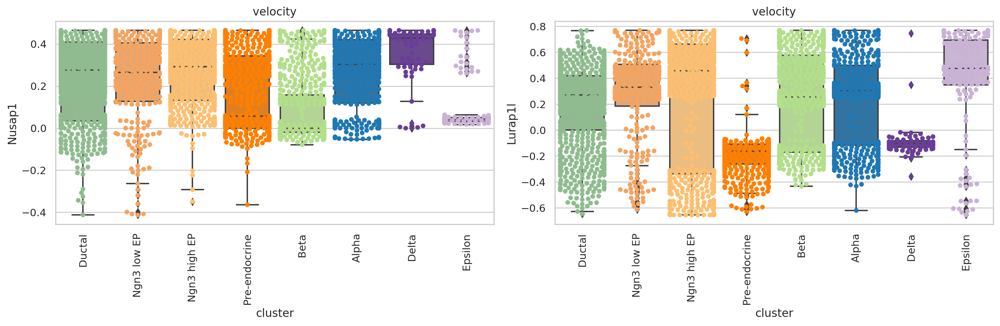

In [38]:
#they have a wide range of velocity 
f, axs = plt.subplots(1,2,figsize=(15,5))

for i,var in enumerate(['Nusap1','Lurap1l']):
    axs[i] = sns.swarmplot(x="cluster", y=var, data=top30_vel_df, palette=colors, order= order, ax=axs[i])
    axs[i] = sns.boxplot(x="cluster", y=var, data=top30_vel_df, palette=colors,order = order, ax=axs[i])
    axs[i].set_title('velocity')
    axs[i].set_xticklabels(labels=order, rotation=90)
plt.savefig("./figures/boxplot_absent.jpg")

In [39]:
oracle.coef_matrix_per_cluster['Ductal']['Lurap1l'] #is not a TF and is not a target of any of them

Sntg1      0.0
Snhg6      0.0
Ncoa2      0.0
Sbspon     0.0
Ube2w      0.0
          ... 
Tmem27     0.0
Uty        0.0
Ddx3y      0.0
Eif2s3y    0.0
Erdr1      0.0
Name: Lurap1l, Length: 2000, dtype: float64

### 3.2 Genes opposite direction

In [40]:
sns.reset_orig()

saving figure to file ./figures/scvelo_wrong_velocity.png


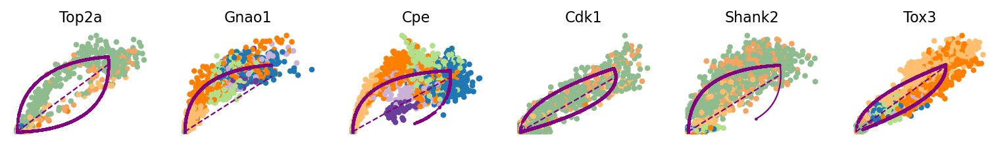

saving figure to file ./figures/scvelo_wrong_time.png


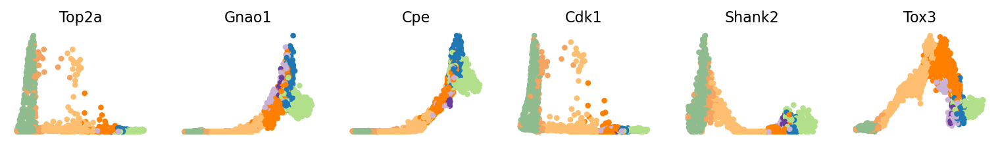

In [41]:
var_names = ['Top2a', 'Gnao1', 'Cpe', 'Cdk1', 'Shank2', 'Tox3']
scv.pl.scatter(top30, var_names, frameon=False, size= 60, dpi = 150, save='wrong_velocity.png')
scv.pl.scatter(top30, x='latent_time', y=var_names, frameon=False, size= 60, dpi=150, save='wrong_time.png')

In [42]:
indices = np.asarray(top30_corr.index[top30_corr['gene'].isin(var_names)])

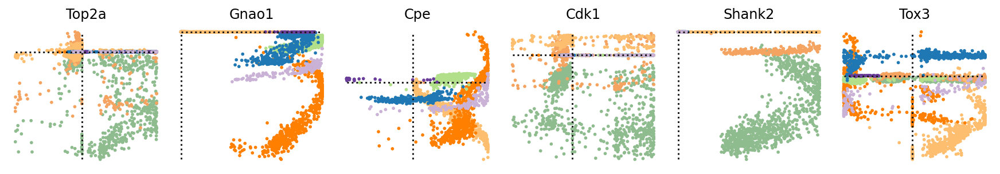

In [43]:
fig, axs = plt.subplots(1, 6, figsize=(12,2),constrained_layout=True)

for i,var in enumerate(var_names):
    j=indices[i]
    sc.pl.scatter(top30, x=var, y=var, layers=('velocity','grn','velocity'), color='clusters',show=False, ax=axs[i])
    axs[i].set_title(var)
    axs[i].set_xlabel('velocity')
    axs[i].set_ylabel('grn')
    axs[i].get_legend().remove()
    axs[i].axis('off')
    min_vel, max_vel = min((top30.layers['velocity'].T)[j]) , max((top30.layers['velocity'].T)[j])
    min_grn, max_grn = min((top30.layers['grn'].T)[j]) , max((top30.layers['grn'].T)[j])
    axs[i].plot([0,0],[min_grn,max_grn], 'k:')
    axs[i].plot([min_vel,max_vel],[0,0], 'k:')

plt.savefig("./figures/top30_grn_wrong.png", dpi=150)

In [44]:
#top30 velocity melt
top30_vel_df_melt = top30_vel_df.melt(value_vars = top30_vel_df.columns[:30], id_vars=['cluster'])
#top30 grn melt
top30_grn_df = pd.DataFrame(top30.layers['grn'])
top30_grn_df.columns = np.asarray(top30.var.index)
top30_grn_df['cluster'] = np.asarray(top30.obs['clusters'])
top30_grn_df_melt = top30_grn_df.melt(value_vars = top30_grn_df.columns[:30], id_vars=['cluster'])
#top30 velocity + grn melt
top30_grn_vel_df = top30_grn_df_melt.merge(top30_vel_df_melt, left_index=True, right_index=True, suffixes=('_grn', '_vel'))
top30_grn_vel_df = top30_grn_vel_df.drop(['cluster_vel','variable_vel'], axis=1)
top30_grn_vel_df.columns = ['cluster','gene','grn','vel']
top30_grn_vel_df['id']=top30_grn_vel_df.index
top30_grn_vel_df_melt = top30_grn_vel_df.melt(id_vars=['id','gene','cluster'], value_vars=['grn','vel']).drop(['id'], axis=1)

In [45]:
from matplotlib import rcParams
rcParams.update({'figure.autolayout': True})

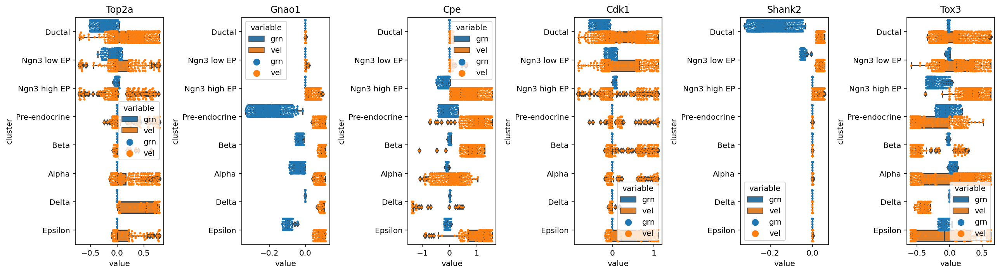

In [46]:
f, axs = plt.subplots(1,6,figsize=(18,5))

for i,var in enumerate(var_names):
    var_df = top30_grn_vel_df_melt[top30_grn_vel_df_melt.gene == var]
    axs[i] = sns.swarmplot(y="cluster", x='value', data=var_df, hue='variable', order=order, dodge=True, orient='h', size=3, ax=axs[i])
    axs[i] = sns.boxplot(y="cluster", x='value', data=var_df, hue='variable', order=order, orient='h', ax=axs[i])
    axs[i].set_title(var)
plt.savefig("./figures/wrong_grn_vel.jpg")

Let's see how the expression looks in all of the clusters:

In [47]:
#Cluster labels per cell
cluster_info = oracle.adata.obs['clusters']

In [48]:
#imputed count
gem_imputed = pd.DataFrame(oracle.adata.layers['imputed_count'], columns = oracle.adata.var.index.values, index=oracle.adata.obs.index.values)
gem_imputed['cluster'] = np.asarray(top30.obs['clusters'])
gem_imputed_df_melt = gem_imputed.melt(value_vars = gem_imputed.columns[:2000], id_vars=['cluster'])
#simulated count
gem_simulated = pd.DataFrame(oracle.adata.layers['simulated_count'], columns = oracle.adata.var.index.values, index=oracle.adata.obs.index.values)
gem_simulated['cluster'] = np.asarray(top30.obs['clusters'])
gem_simulated_df_melt = gem_simulated.melt(value_vars = gem_simulated.columns[:2000], id_vars=['cluster'])
#imputed + simulated melt
gem_df = gem_imputed_df_melt.merge(gem_simulated_df_melt, left_index=True, right_index=True, suffixes=('_im', '_sim'))
gem_df = gem_df.drop(['cluster_im','variable_im'], axis=1)
gem_df.columns = ['imputed','cluster','gene','simulated']
gem_df['id']=gem_df.index
gem_df_melt = gem_df.melt(id_vars=['id','gene','cluster'], value_vars=['imputed','simulated']).drop(['id'], axis=1)

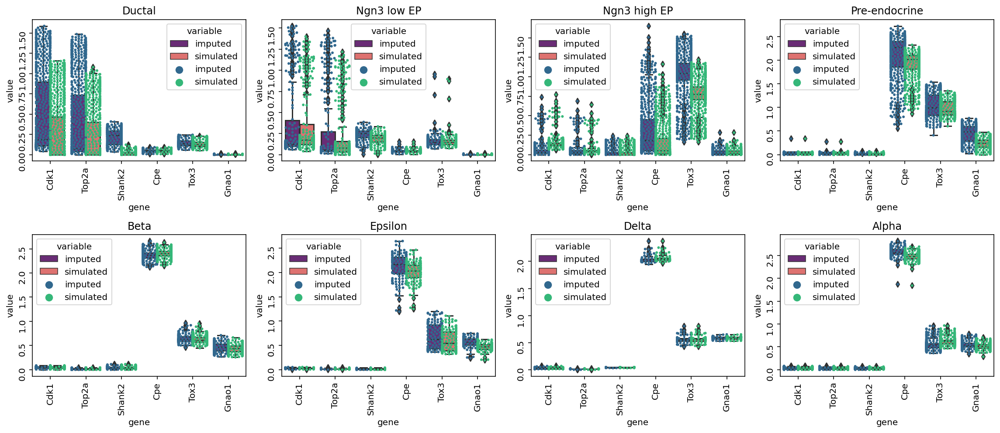

In [49]:
f, axs = plt.subplots(2,4,figsize=(16,7))

for i,clus in enumerate(order):
    if i <4:
        j=0
        k=i
    else:
        j=1
        k=4-i
    var_df = gem_df_melt[gem_df_melt.cluster == clus][gem_df_melt['gene'].isin(var_names)]
    sns.swarmplot(x="gene", y='value', data=var_df, hue='variable', dodge=True, orient='v', size=3, ax=axs[j,k], palette='viridis')
    sns.boxplot(x="gene", y='value', data=var_df, hue='variable', orient='v', ax=axs[j,k], palette='magma')
    axs[j,k].set_title(clus)
    axs[j,k].tick_params(labelrotation=90)
plt.savefig("./figures/wrong_grn_ex.jpg")

In [50]:
#by their behaviour, we can divide the genes in two sets:
set1 = ['Top2a', 'Cdk1','Shank2']
set2 = ['Gnao1', 'Cpe']

Analysis of set 1:
1. Shank2
2. Cdk1
3. Top2a

In [51]:
#lets see if they have TFs in common
coefs_ductal_set1 = oracle.coef_matrix_per_cluster['Ductal'][set1]
coefs_ductal_set1 = coefs_ductal_set1[(coefs_ductal_set1.T != 0).any()]
coefs_ductal_set1['max_abs'] = coefs_ductal_set1.abs().max(axis=1)
coefs_ductal_set1=coefs_ductal_set1.sort_values(by='max_abs', ascending=False)
coefs_ductal_set1 = coefs_ductal_set1.drop('max_abs', axis=1)
coefs_ductal_set1['gene']=coefs_ductal_set1.index
coefs_ductal_set1_melt = coefs_ductal_set1.melt(value_vars = set1, id_vars=['gene'])

In [52]:
sns.set_style("whitegrid")

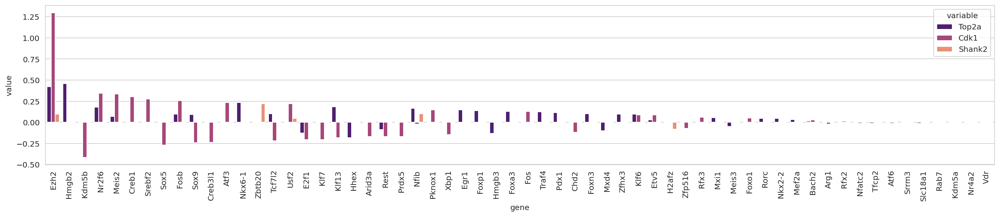

In [53]:
plt.figure(figsize=(18,4))
sns.barplot(x='gene', y='value', hue='variable', data = coefs_ductal_set1_melt, palette='magma')
plt.xticks(rotation=90)
plt.savefig("./figures/wrong_coefs_ductal_set1.jpg")

In [54]:
sns.reset_orig()
rcParams.update({'figure.autolayout': True})

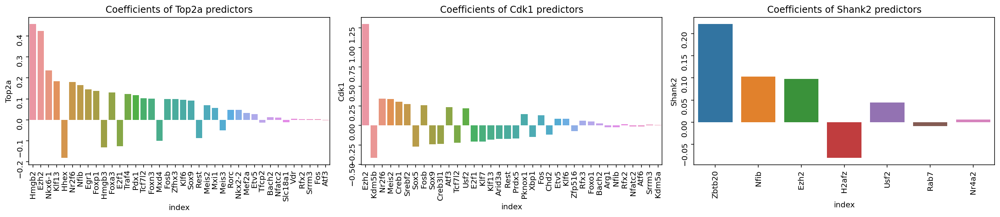

In [65]:
#coefficients for genes in Set1
f, axs = plt.subplots(1,3, figsize=(18,4))

for i, gene in enumerate(set1):
    temp = oracle.coef_matrix_per_cluster['Ductal'][gene]
    temp = pd.DataFrame(temp[temp!=0]).reset_index()
    temp['abs'] = np.abs(temp[gene])
    temp = temp.sort_values(by='abs', ascending=False)
    sns.barplot(data=temp, x='index', y=gene, ax=axs[i])
    axs[i].tick_params(labelrotation=90)
    axs[i].set_title('Coefficients of ' + str(gene) + ' predictors' )
plt.savefig("./figures/wrong_set1_coefs.jpg")

How do the top Transcription Factors for each gene behave?

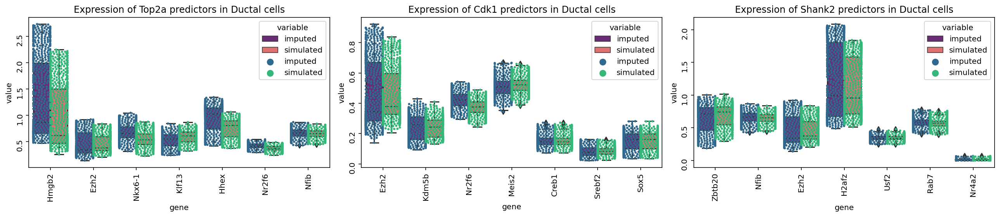

In [72]:
f, axs = plt.subplots(1,3, figsize=(18,4))

for i, gene in enumerate(set1):
    temp = oracle.coef_matrix_per_cluster['Ductal'][gene]
    temp = pd.DataFrame(temp[temp!=0]).reset_index()
    temp['abs'] = np.abs(temp[gene])
    temp = temp.sort_values(by='abs', ascending=False)
    var_df = gem_df_melt[gem_df_melt.cluster == 'Ductal'][gem_df_melt['gene'].isin(temp['index'][:7])]
    sns.swarmplot(x="gene", y='value', data=var_df, hue='variable', dodge=True, orient='v', size=3, palette='viridis', order=temp['index'][:7], ax = axs[i])
    sns.boxplot(x="gene", y='value', data=var_df, hue='variable', orient='v', palette='magma', order=temp['index'][:7], ax=axs[i])
    axs[i].tick_params(labelrotation=90)
    axs[i].set_title('Expression of ' + str(gene) + ' predictors in Ductal cells' )
plt.savefig("./figures/wrong_set1_TFs_expression.jpg")

### Cdk1 Analysis

In [73]:
#Ductal cells, simulated, imputed and the difference.
ductal_sim = gem_simulated[gem_simulated.cluster == 'Ductal']
ductal_im = gem_imputed[gem_imputed.cluster == 'Ductal']
ductal_dif = ductal_sim.drop('cluster', axis=1) - ductal_im.drop('cluster', axis=1)

In [108]:
gene='Cdk1'

In [76]:
temp = oracle.coef_matrix_per_cluster['Ductal'][gene]
temp = pd.DataFrame(temp[temp!=0]).reset_index()
temp['abs'] = np.abs(temp[gene])
temp = temp.sort_values(by='abs', ascending=False)

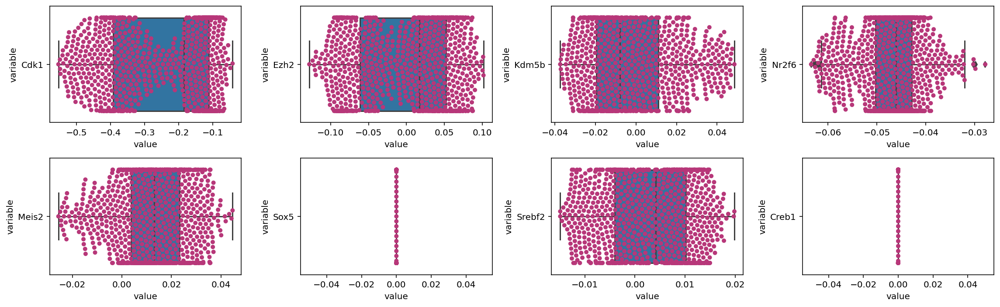

In [93]:
#Two of the top genes for the prediction of Cdk1 remain constant.
temp_melt = ductal_dif[[gene] + list(temp['index'][:7])].melt()
fig, axs = plt.subplots(2,4,figsize=(16,5))

for i, gene in enumerate([gene] + list(temp['index'][:7])):
    if i <4:
        j=0
        k=i
    else:
        j=1
        k=4-i
    sns.boxplot(data=temp_melt[temp_melt['variable']==gene], y='variable', x='value', orient='h', ax=axs[j,k])
    sns.swarmplot(data=temp_melt[temp_melt['variable']==gene], y='variable', x='value', palette='magma', orient='h', ax=axs[j,k])

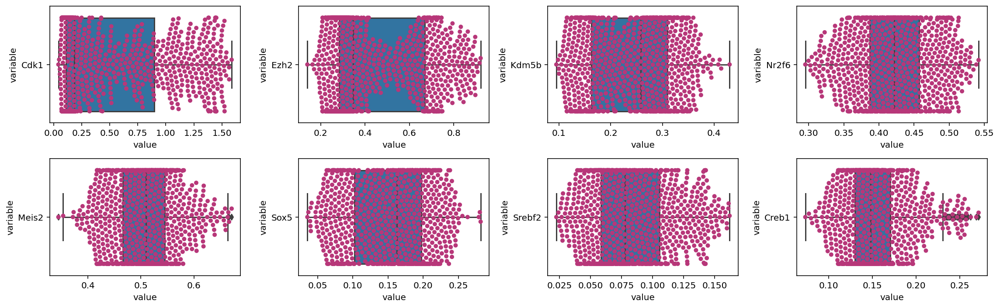

In [106]:
#Two evident clusters in the initial expression
temp_melt = ductal_im[[gene] + list(temp['index'][:7])].melt()
fig, axs = plt.subplots(2,4,figsize=(16,5))

for i, gene in enumerate([gene] + list(temp['index'][:7])):
    if i <4:
        j=0
        k=i
    else:
        j=1
        k=4-i
    sns.boxplot(data=temp_melt[temp_melt['variable']==gene], y='variable', x='value', orient='h', ax=axs[j,k])
    sns.swarmplot(data=temp_melt[temp_melt['variable']==gene], y='variable', x='value', palette='magma', orient='h', ax=axs[j,k])

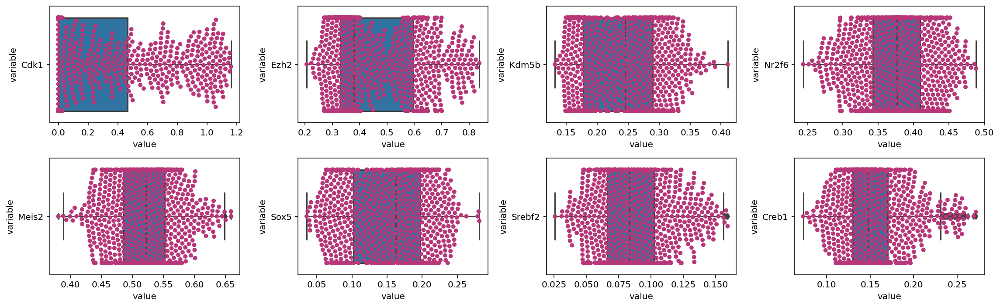

In [109]:
#In the simulation, the expression seems to mantain the shape
temp_melt = ductal_sim[[gene] + list(temp['index'][:7])].melt()
fig, axs = plt.subplots(2,4,figsize=(16,5))

for i, gene in enumerate([gene] + list(temp['index'][:7])):
    if i <4:
        j=0
        k=i
    else:
        j=1
        k=4-i
    sns.boxplot(data=temp_melt[temp_melt['variable']==gene], y='variable', x='value', orient='h', ax=axs[j,k])
    sns.swarmplot(data=temp_melt[temp_melt['variable']==gene], y='variable', x='value', palette='magma', orient='h', ax=axs[j,k])

In [111]:
gene='Cdk1'

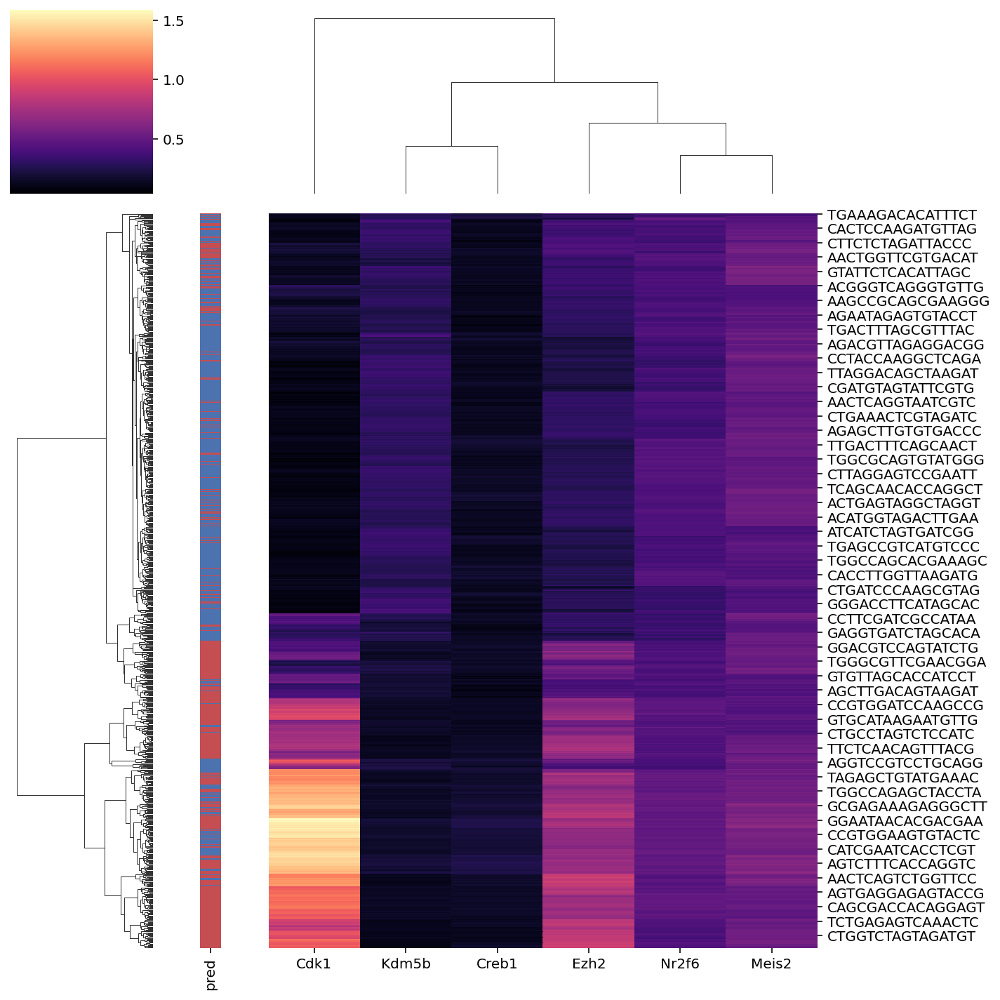

In [113]:
#it is pretty evident that Ezh2 and Kdm5b are the TFs with most impact in Cdk1
heatmap_df = ductal_im[[gene] + list(temp['index'][:5])]
species = gene_df_ductal['pred']
lut = dict(zip(species.unique(), "rbg"))
row_colors = species.map(lut)
sns.clustermap(heatmap_df, cmap="magma", row_colors=row_colors)
plt.savefig('./figures/cdk1_heatmap_imputed.jpg')

Trying to find a pattern in the imputed count that gives us a clue of which genes will be predicted correctly and which ones not.

In [114]:
#info of where the predictions are consistent and inconsistent
gene_df = (top30_grn_vel_df[top30_grn_vel_df['gene']==gene])
gene_df.index = oracle.adata.obs.index.values
gene_df_ductal = gene_df[gene_df['cluster']=='Ductal']
gene_df_ductal['pred'] = np.where(gene_df_ductal['grn']*gene_df_ductal['vel']>0, 'right', 'wrong')
gene_df_ductal.head()

,cluster,gene,grn,vel,id,pred
AAACCTGAGCCTTGAT,Ductal,Cdk1,-0.099996,0.173132,73921,wrong
AAACCTGCATCATCCC,Ductal,Cdk1,-0.470376,0.918414,73923,wrong
AAACCTGGTATTAGCC,Ductal,Cdk1,-0.143037,-0.270216,73925,right
AAACCTGTCTTTCCTC,Ductal,Cdk1,-0.401043,0.848140,73927,wrong
AAACGGGAGACAATAC,Ductal,Cdk1,-0.364510,-0.442995,73928,right


score:  0.7925764192139738

Cdk1 0.0
Ezh2 1.0
Kdm5b 0.0
Nr2f6 0.0
Meis2 0.0
Creb1 0.0
Srebf2 0.0
Sox5 0.0
Fosb 0.0
Sox9 0.0
Creb3l1 0.0


[Text(167.4, 163.07999999999998, 'X[1] <= 0.345\ngini = 0.493\nsamples = 916\nvalue = [512, 404]'),
 Text(83.7, 54.360000000000014, 'gini = 0.248\nsamples = 454\nvalue = [388, 66]'),
 Text(251.10000000000002, 54.360000000000014, 'gini = 0.393\nsamples = 462\nvalue = [124, 338]')]

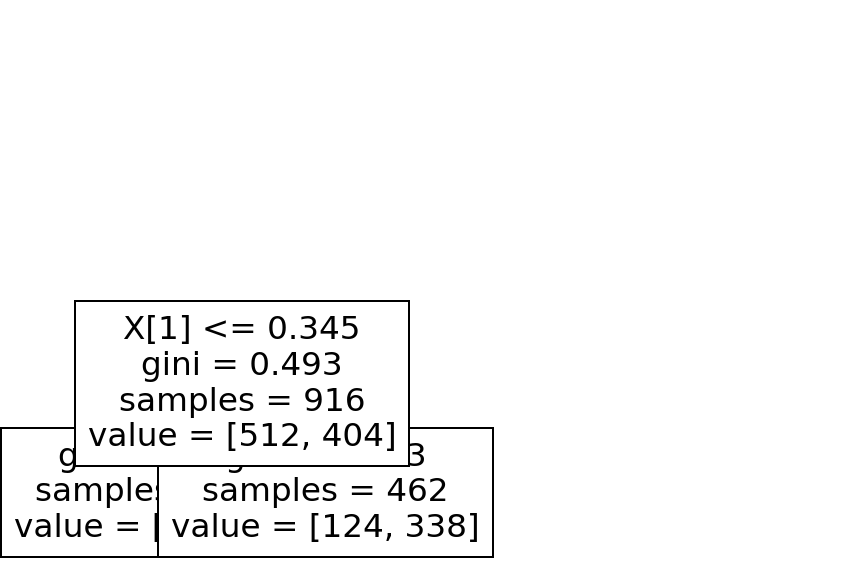

In [118]:
from sklearn import tree

Y = np.asarray(gene_df_ductal['pred'])
X = ductal_im[['Cdk1'] + list(temp['index'][:10])]

clf = tree.DecisionTreeClassifier(max_depth = 1)
clf.fit(X, Y)

print('score: ', clf.score(X,Y))
print('')
importances = clf.feature_importances_

for i, el in enumerate(['Cdk1'] + list(temp['index'][:10])):
    print(el, importances[i])
tree.plot_tree(clf) 

Just with the levels of Ezh2, we have an accuracy of 80% in predicting where CellOracle is right and where is wrong. Then, I will plot the expression and the phase trajectories to see the dynamics of these cells.

In [119]:
temp_df = oracle.adata.obs.copy()
temp_df['cdk1_pred'] = np.where(oracle.adata[:,'Cdk1'].layers['grn']*oracle.adata[:,'Cdk1'].layers['velocity']>0, 'right', 'wrong')
temp_df['new_clusters'] = (temp_df['clusters'].astype(str) + '_' + temp_df['cdk1_pred']).astype(str)
mask = temp_df['clusters'] == 'Ductal'
temp_df.loc[~mask, 'new_clusters'] = temp_df[~mask].clusters.values
temp_df.head()

,clusters_coarse,clusters,S_score,G2M_score,initial_size_spliced,initial_size_unspliced,initial_size,n_counts,grn_self_transition,velocity_self_transition,root_cells,end_points,velocity_pseudotime,latent_time,cdk1_pred,new_clusters
index,,,,,,,,,,,,,,,,
AAACCTGAGAGGGATA,Pre-endocrine,Pre-endocrine,-0.224902,-0.252071,4954.0,1575.0,4954.0,5410.060059,0.299720,0.197906,0.000000,0.000004,0.817098,0.805363,wrong,Pre-endocrine
AAACCTGAGCCTTGAT,Ductal,Ductal,-0.014707,-0.232610,7071.0,978.0,7071.0,5476.578125,0.269713,0.606334,0.292936,0.000016,0.067910,0.106644,wrong,Ductal_wrong
AAACCTGAGGCAATTA,Endocrine,Alpha,-0.171255,-0.286834,4070.0,1095.0,4070.0,5436.109863,0.050375,0.270917,0.000000,0.000011,0.843436,0.829772,wrong,Alpha
AAACCTGCATCATCCC,Ductal,Ductal,0.599244,0.191243,8362.0,1655.0,8362.0,5505.859863,0.121908,0.509671,0.489046,0.000005,0.032580,0.069723,wrong,Ductal_wrong
AAACCTGGTAAGTGGC,Ngn3 high EP,Ngn3 high EP,-0.179981,-0.126030,5026.0,1014.0,5026.0,5473.050781,0.288949,0.084321,0.000000,0.000011,0.588742,0.589501,wrong,Ngn3 high EP


In [120]:
#modify adata to be able to plot
oracle.adata.obs['new_clusters']=temp_df['new_clusters']

In [122]:
#adata to plot
adata_plot = oracle.adata.copy()
adata_plot.obs = adata_plot.obs.drop(['clusters'], axis=1)
del adata_plot.uns['clusters_colors']
adata_plot.uns['clusters_colors'] = ['#1f78b4', '#b2df8a', '#6a3d9a', '#8fbc8f', '#3fbf3f', '#cab2d6', '#fdbf6f', '#f4a460', '#ff7f00']
adata_plot.obs.rename(columns={'new_clusters':'clusters'}, inplace=True)

saving figure to file ./figures/scvelo_ductal_right1.png


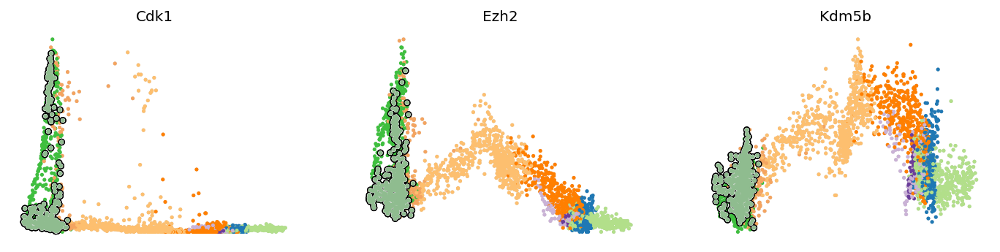

In [123]:
scv.pl.scatter(adata_plot, x='latent_time', y=['Cdk1','Ezh2','Kdm5b'], add_outline = 'Ductal_right', groups = 'new_clusters', frameon=False, save = 'ductal_right1.png')

saving figure to file ./figures/scvelo_ductal_wrong1.png


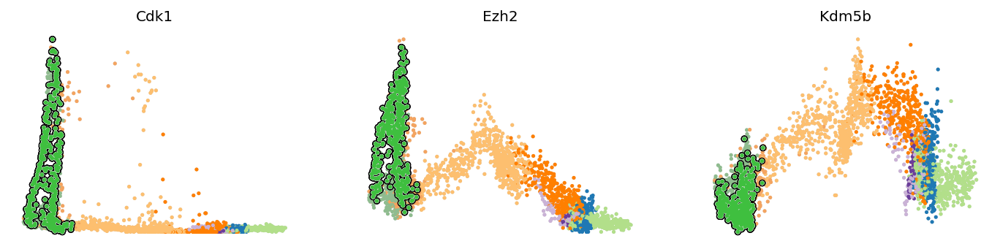

In [124]:
scv.pl.scatter(adata_plot, x='latent_time', y=['Cdk1','Ezh2','Kdm5b'], add_outline = 'Ductal_wrong', groups = 'new_clusters', frameon=False, save = 'ductal_wrong1.png')

saving figure to file ./figures/scvelo_ductal_wrong_umap.png


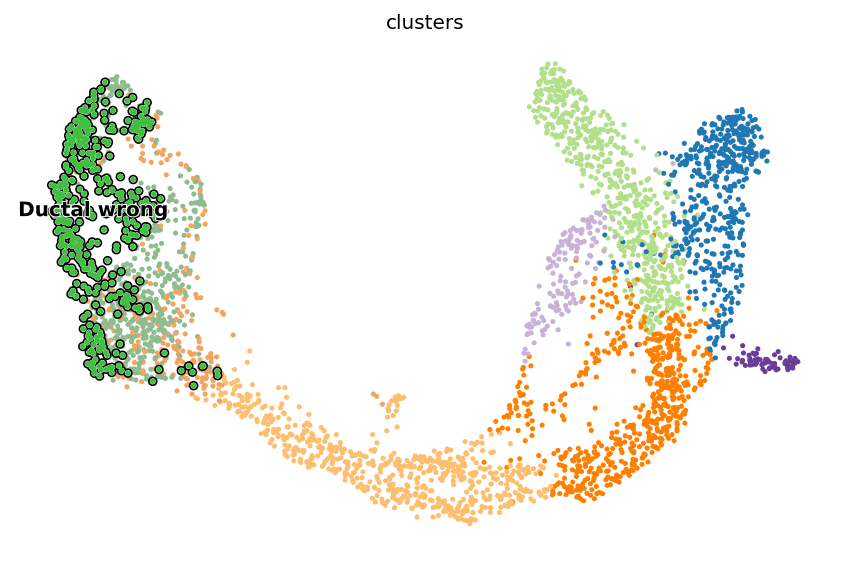

In [125]:
scv.pl.scatter(adata_plot, add_outline = 'Ductal_wrong', save='ductal_wrong_umap.png')

saving figure to file ./figures/scvelo_ductal_right_umap.png


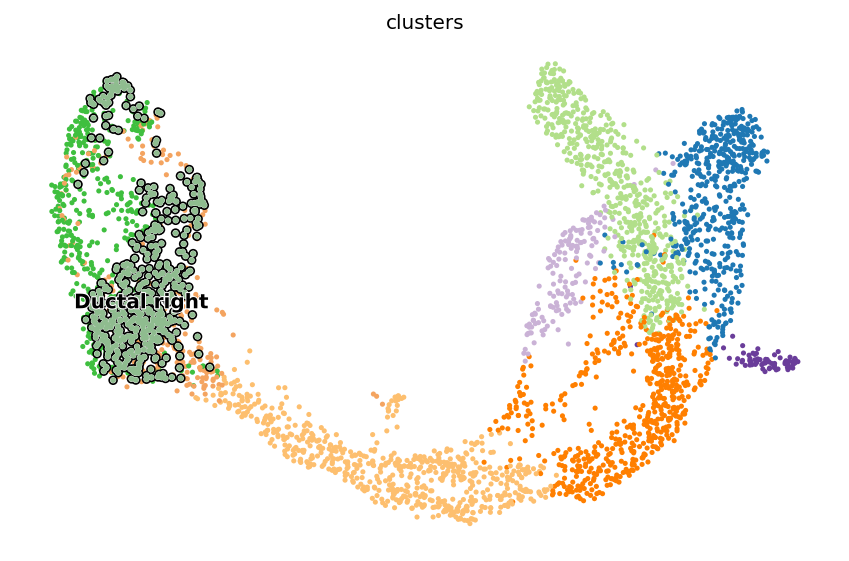

In [126]:
scv.pl.scatter(adata_plot, add_outline = 'Ductal_right', save='ductal_right_umap.png')

saving figure to file ./figures/scvelo_ductal_wrong_trajectory.png


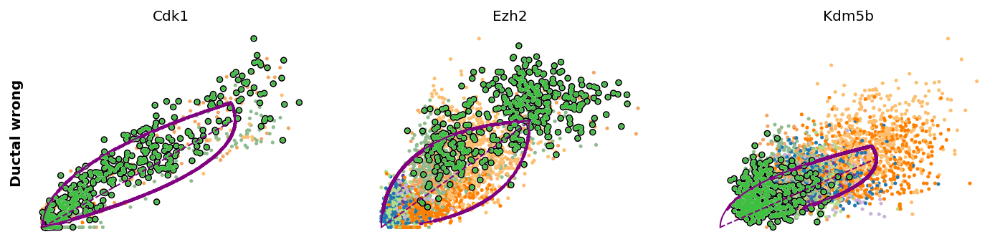

In [127]:
scv.pl.scatter(adata_plot, ['Cdk1','Ezh2','Kdm5b'], ylabel='Ductal_wrong', add_outline = 'Ductal_wrong', frameon=False, save='ductal_wrong_trajectory.png')

saving figure to file ./figures/scvelo_ductal_right_trajectory.png


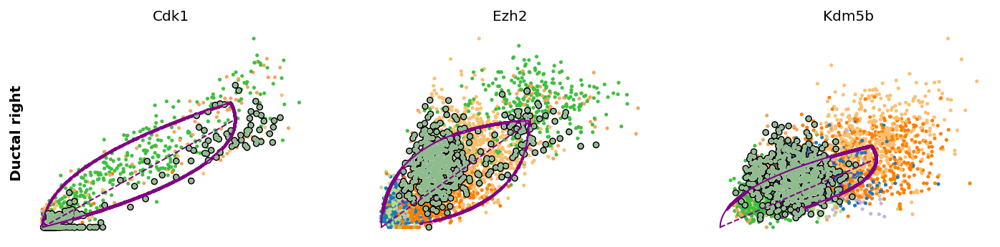

In [128]:
scv.pl.scatter(adata_plot, ['Cdk1','Ezh2','Kdm5b'], ylabel='Ductal_right', add_outline = 'Ductal_right', frameon=False, save='ductal_right_trajectory.png')

<AxesSubplot:xlabel='Cdk1', ylabel='Ezh2'>

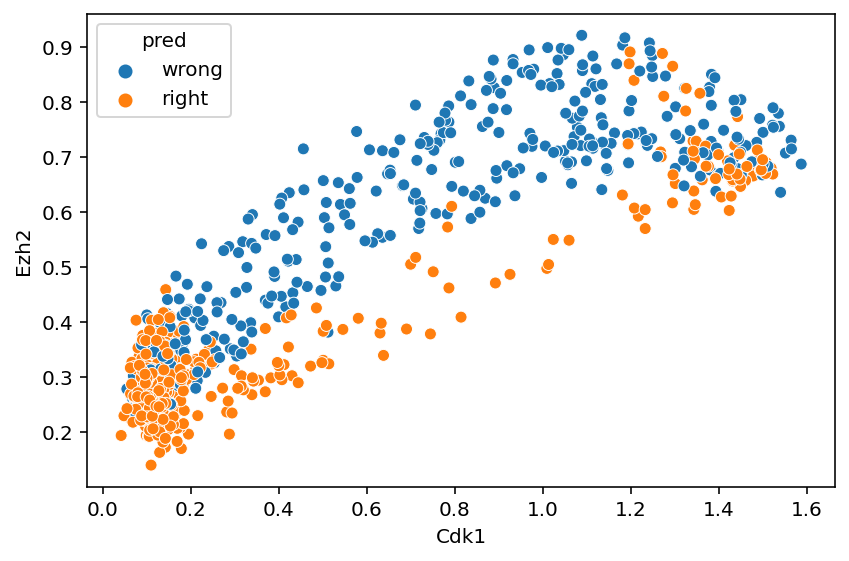

In [129]:
df_plot = ductal_im[['Cdk1', 'Kdm5b', 'Ezh2', 'Sox9', 'Srebf2']]
df_plot['pred'] = np.where(gene_df_ductal['grn']*gene_df_ductal['vel']>0, 'right', 'wrong')
sns.scatterplot(data=df_plot, x='Cdk1', y="Ezh2", hue='pred')
#plt.savefig('./figures/cdk1_ezh2.jpg')

### Top2a Analysis

In [172]:
gene='Top2a'

In [173]:
temp = oracle.coef_matrix_per_cluster['Ductal'][gene]
temp = pd.DataFrame(temp[temp!=0]).reset_index()
temp['abs'] = np.abs(temp[gene])
temp = temp.sort_values(by='abs', ascending=False)

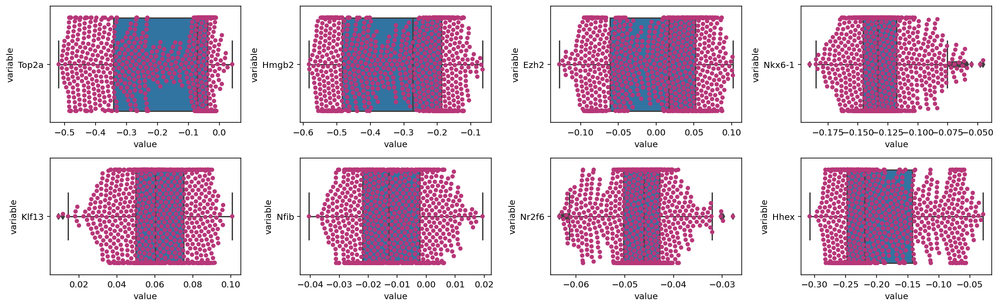

In [174]:
#Difference
temp_melt = ductal_dif[[gene] + list(temp['index'][:7])].melt()
fig, axs = plt.subplots(2,4,figsize=(16,5))

for i, gene in enumerate([gene] + list(temp['index'][:7])):
    if i <4:
        j=0
        k=i
    else:
        j=1
        k=4-i
    sns.boxplot(data=temp_melt[temp_melt['variable']==gene], y='variable', x='value', orient='h', ax=axs[j,k])
    sns.swarmplot(data=temp_melt[temp_melt['variable']==gene], y='variable', x='value', palette='magma', orient='h', ax=axs[j,k])

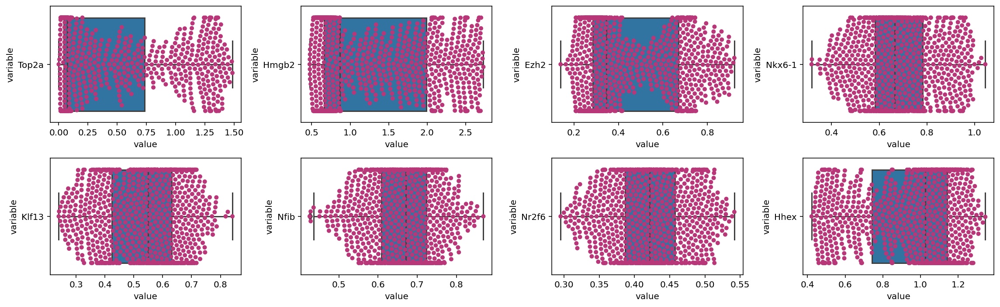

In [175]:
#Two evident clusters in the initial expression
gene='Top2a'
temp_melt = ductal_im[[gene] + list(temp['index'][:7])].melt()
fig, axs = plt.subplots(2,4,figsize=(16,5))

for i, gene in enumerate([gene] + list(temp['index'][:7])):
    if i <4:
        j=0
        k=i
    else:
        j=1
        k=4-i
    sns.boxplot(data=temp_melt[temp_melt['variable']==gene], y='variable', x='value', orient='h', ax=axs[j,k])
    sns.swarmplot(data=temp_melt[temp_melt['variable']==gene], y='variable', x='value', palette='magma', orient='h', ax=axs[j,k])

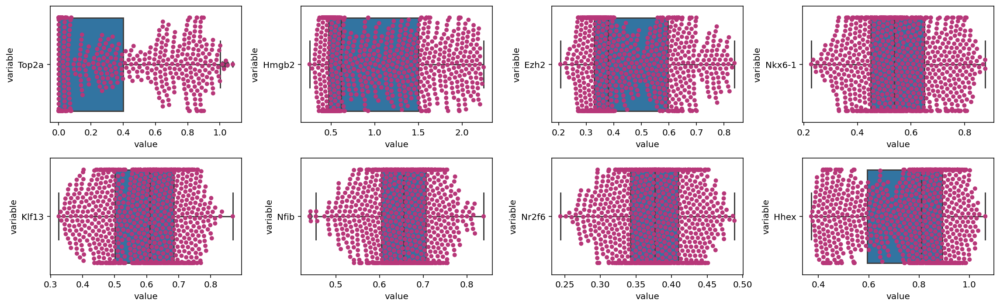

In [176]:
#In the simulation, the expression seems to mantain the shape
gene='Top2a'
temp_melt = ductal_sim[[gene] + list(temp['index'][:7])].melt()
fig, axs = plt.subplots(2,4,figsize=(16,5))

for i, gene in enumerate([gene] + list(temp['index'][:7])):
    if i <4:
        j=0
        k=i
    else:
        j=1
        k=4-i
    sns.boxplot(data=temp_melt[temp_melt['variable']==gene], y='variable', x='value', orient='h', ax=axs[j,k])
    sns.swarmplot(data=temp_melt[temp_melt['variable']==gene], y='variable', x='value', palette='magma', orient='h', ax=axs[j,k])

In [177]:
gene='Top2a'

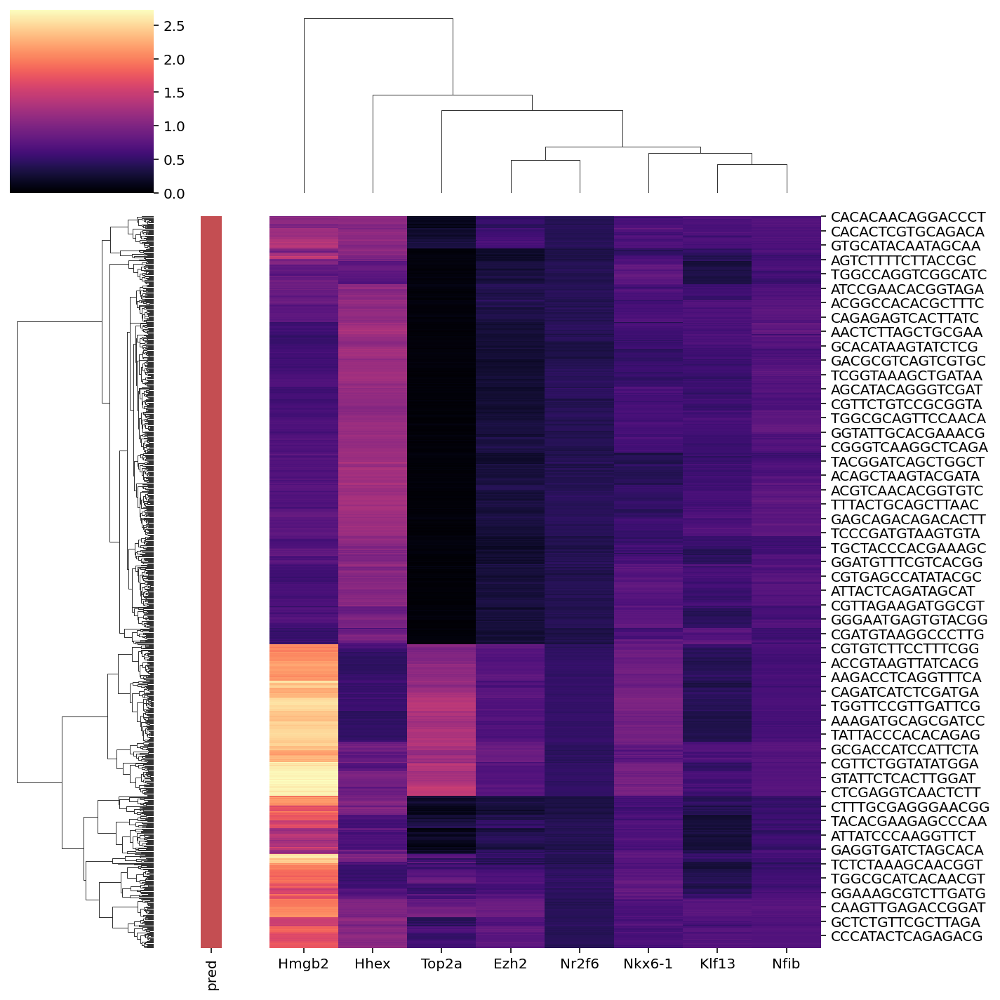

In [178]:
#it is pretty evident that Ezh2 and Kdm5b are the TFs with most impact in Cdk1
heatmap_df = ductal_im[[gene] + list(temp['index'][:7])]
species = gene_df_ductal['pred']
lut = dict(zip(species.unique(), "rbg"))
row_colors = species.map(lut)
sns.clustermap(heatmap_df, cmap="magma", row_colors=row_colors)
plt.savefig('./figures/top2a_heatmap_imputed.jpg')

In [179]:
#info of where the predictions are consistent and inconsistent
gene_df = (top30_grn_vel_df[top30_grn_vel_df['gene']==gene])
gene_df.index = oracle.adata.obs.index.values
gene_df_ductal = gene_df[gene_df['cluster']=='Ductal']
gene_df_ductal['pred'] = np.where(gene_df_ductal['grn']*gene_df_ductal['vel']>0, 'right', 'wrong')
gene_df_ductal.head()

,cluster,gene,grn,vel,id,pred
AAACCTGAGCCTTGAT,Ductal,Top2a,-0.043464,0.330124,14785,wrong
AAACCTGCATCATCCC,Ductal,Top2a,-0.334472,0.538652,14787,wrong
AAACCTGGTATTAGCC,Ductal,Top2a,-0.048281,-0.070078,14789,right
AAACCTGTCTTTCCTC,Ductal,Top2a,-0.285785,0.562025,14791,wrong
AAACGGGAGACAATAC,Ductal,Top2a,-0.483861,0.070519,14792,wrong


score:  0.8013100436681223



[Text(167.4, 181.2, 'X[1] <= 0.344\ngini = 0.48\nsamples = 916\nvalue = [367, 549]'),
 Text(83.7, 108.72, 'X[1] <= 0.282\ngini = 0.417\nsamples = 453\nvalue = [319, 134]'),
 Text(41.85, 36.23999999999998, 'gini = 0.308\nsamples = 226\nvalue = [183, 43]'),
 Text(125.55000000000001, 36.23999999999998, 'gini = 0.48\nsamples = 227\nvalue = [136, 91]'),
 Text(251.10000000000002, 108.72, 'X[1] <= 0.381\ngini = 0.186\nsamples = 463\nvalue = [48, 415]'),
 Text(209.25, 36.23999999999998, 'gini = 0.47\nsamples = 53\nvalue = [20, 33]'),
 Text(292.95, 36.23999999999998, 'gini = 0.127\nsamples = 410\nvalue = [28, 382]')]

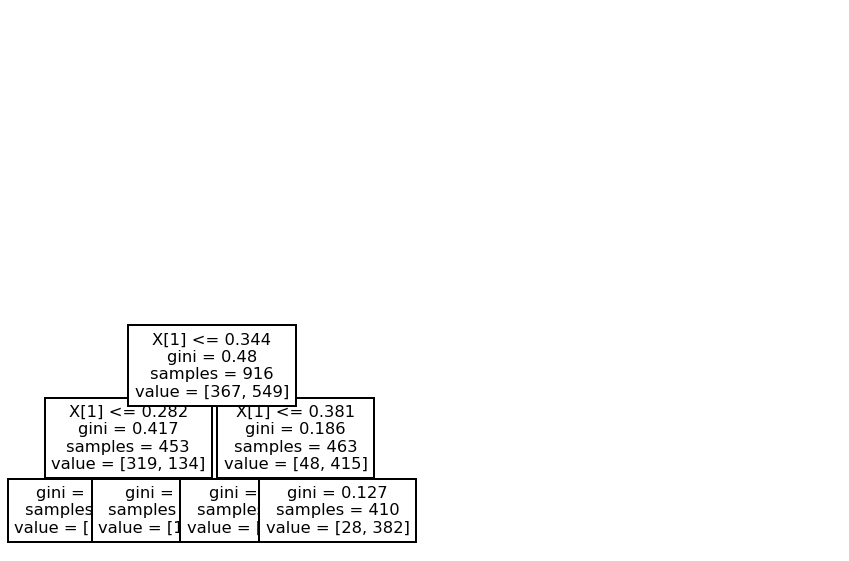

In [183]:
gene='Top2a'
Y = np.asarray(gene_df_ductal['pred'])
#X = ductal_im[[gene] + list(temp['index'][:10])]
X = ductal_im[[gene, 'Ezh2']]
clf = tree.DecisionTreeClassifier(max_depth = 2)
clf.fit(X, Y)

print('score: ', clf.score(X,Y))
print('')
importances = clf.feature_importances_

#for i, el in enumerate([gene] + list(temp['index'][:10])):
#    print(el, importances[i])
tree.plot_tree(clf) 

In [ ]:
temp_df = oracle.adata.obs.copy()
temp_df['pred'] = np.where(oracle.adata[:,gene].layers['grn']*oracle.adata[:,gene].layers['velocity']>0, 'right', 'wrong')
temp_df['new_clusters'] = (temp_df['clusters'].astype(str) + '_' + temp_df['pred']).astype(str)
mask = temp_df['clusters'] == 'Ductal'
temp_df.loc[~mask, 'new_clusters'] = temp_df[~mask].clusters.values
temp_df.head()

In [ ]:
#modify adata to be able to plot
oracle.adata.obs['new_clusters']=temp_df['new_clusters']

In [ ]:
#adata to plot
adata_plot = oracle.adata.copy()
adata_plot.obs = adata_plot.obs.drop(['clusters'], axis=1)
del adata_plot.uns['clusters_colors']
adata_plot.uns['clusters_colors'] = ['#1f78b4', '#b2df8a', '#6a3d9a', '#8fbc8f', '#3fbf3f', '#cab2d6', '#fdbf6f', '#f4a460', '#ff7f00']
adata_plot.obs.rename(columns={'new_clusters':'clusters'}, inplace=True)

saving figure to file ./figures/scvelo_ductal_right1_top2a.png


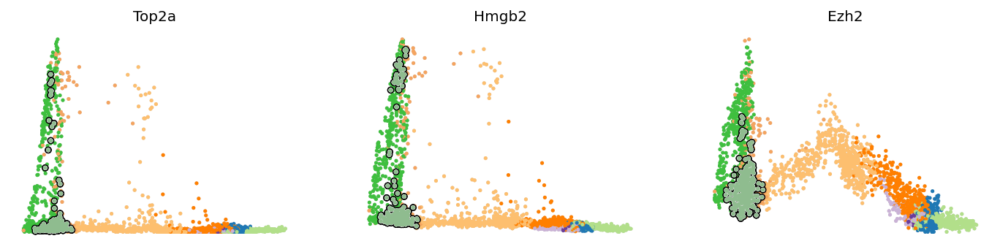

In [149]:
scv.pl.scatter(adata_plot, x='latent_time', y=['Top2a','Hmgb2','Ezh2'], add_outline = 'Ductal_right', groups = 'new_clusters', frameon=False, save = 'ductal_right1_top2a.png')

saving figure to file ./figures/scvelo_ductal_wrong1_top2a.png


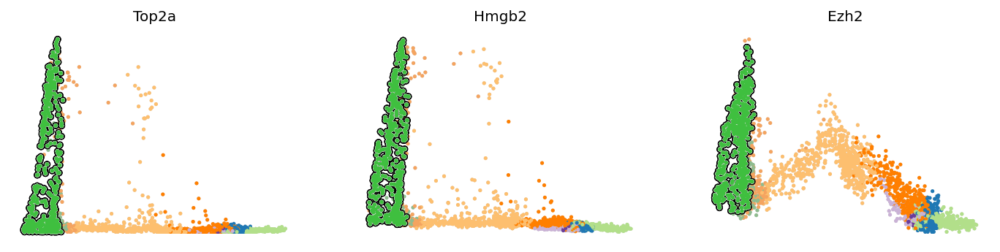

In [150]:
scv.pl.scatter(adata_plot, x='latent_time', y=['Top2a','Hmgb2','Ezh2'], add_outline = 'Ductal_wrong', groups = 'new_clusters', frameon=False, save = 'ductal_wrong1_top2a.png')

saving figure to file ./figures/scvelo_ductal_wrong_umap_top2a.png


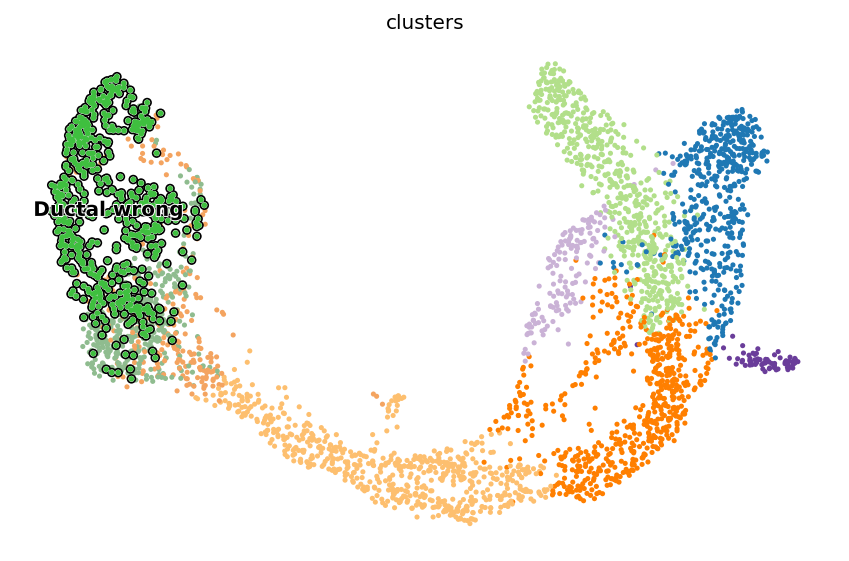

In [151]:
scv.pl.scatter(adata_plot, add_outline = 'Ductal_wrong', save='ductal_wrong_umap_top2a.png')

saving figure to file ./figures/scvelo_ductal_right_umap_top2a.png


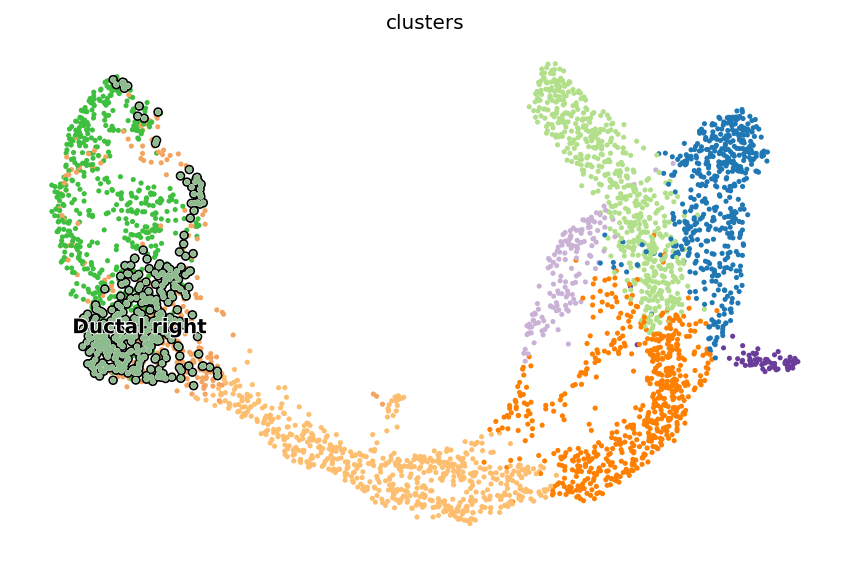

In [152]:
scv.pl.scatter(adata_plot, add_outline = 'Ductal_right', save='ductal_right_umap_top2a.png')

saving figure to file ./figures/scvelo_ductal_wrong_trajectory_top2a.png


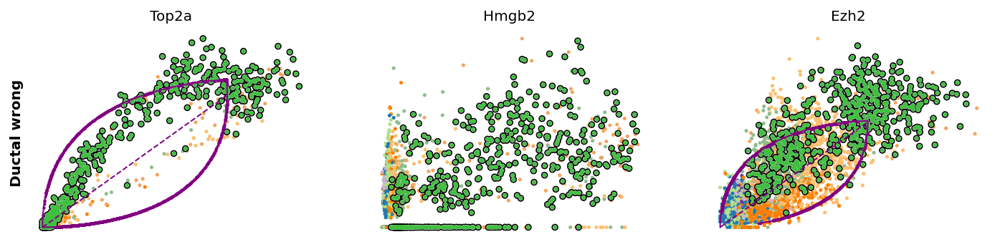

In [153]:
scv.pl.scatter(adata_plot, ['Top2a','Hmgb2','Ezh2'], ylabel='Ductal_wrong', add_outline = 'Ductal_wrong', frameon=False, save='ductal_wrong_trajectory_top2a.png')

saving figure to file ./figures/scvelo_ductal_right_trajectory_top2a.png


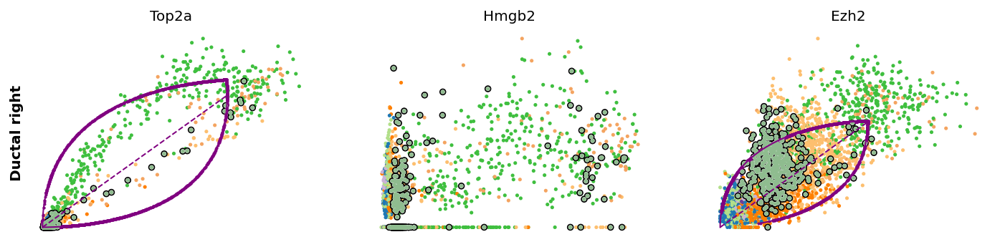

In [154]:
scv.pl.scatter(adata_plot, ['Top2a','Hmgb2','Ezh2'], ylabel='Ductal_right', add_outline = 'Ductal_right', frameon=False, save='ductal_right_trajectory_top2a.png')

### Shank2 Analysis

In [155]:
gene='Shank2'

In [156]:
temp = oracle.coef_matrix_per_cluster['Ductal'][gene]
temp = pd.DataFrame(temp[temp!=0]).reset_index()
temp['abs'] = np.abs(temp[gene])
temp = temp.sort_values(by='abs', ascending=False)

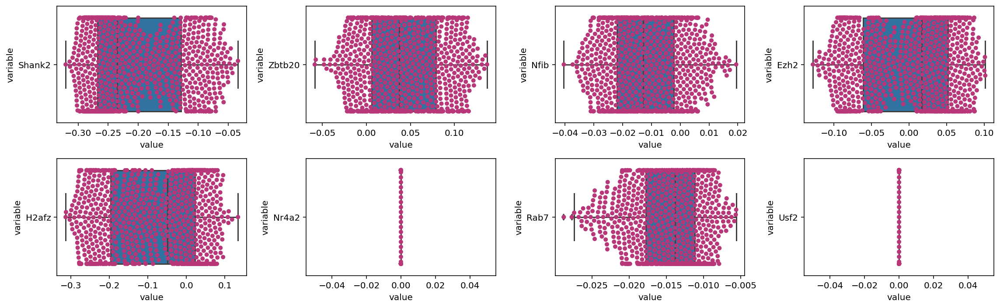

In [157]:
#Difference
temp_melt = ductal_dif[[gene] + list(temp['index'][:7])].melt()
fig, axs = plt.subplots(2,4,figsize=(16,5))

for i, gene in enumerate([gene] + list(temp['index'][:7])):
    if i <4:
        j=0
        k=i
    else:
        j=1
        k=4-i
    sns.boxplot(data=temp_melt[temp_melt['variable']==gene], y='variable', x='value', orient='h', ax=axs[j,k])
    sns.swarmplot(data=temp_melt[temp_melt['variable']==gene], y='variable', x='value', palette='magma', orient='h', ax=axs[j,k])

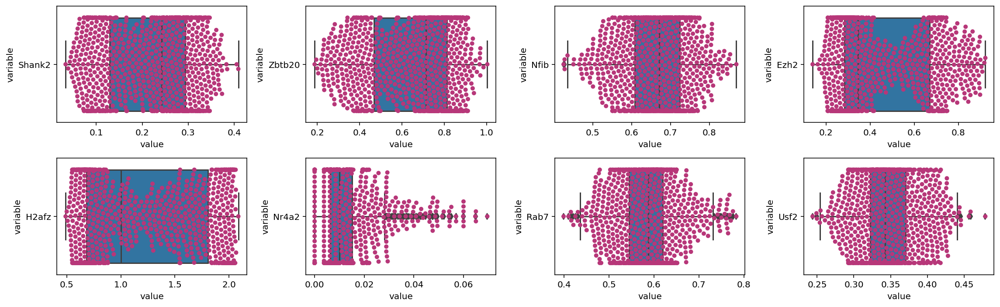

In [159]:
#Two evident clusters in the initial expression
gene='Shank2'
temp_melt = ductal_im[[gene] + list(temp['index'][:7])].melt()
fig, axs = plt.subplots(2,4,figsize=(16,5))

for i, gene in enumerate([gene] + list(temp['index'][:7])):
    if i <4:
        j=0
        k=i
    else:
        j=1
        k=4-i
    sns.boxplot(data=temp_melt[temp_melt['variable']==gene], y='variable', x='value', orient='h', ax=axs[j,k])
    sns.swarmplot(data=temp_melt[temp_melt['variable']==gene], y='variable', x='value', palette='magma', orient='h', ax=axs[j,k])

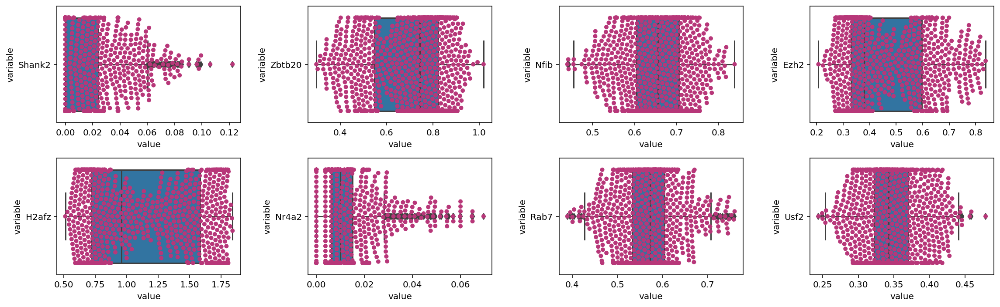

In [160]:
#In the simulation, the expression seems to mantain the shape
gene='Shank2'
temp_melt = ductal_sim[[gene] + list(temp['index'][:7])].melt()
fig, axs = plt.subplots(2,4,figsize=(16,5))

for i, gene in enumerate([gene] + list(temp['index'][:7])):
    if i <4:
        j=0
        k=i
    else:
        j=1
        k=4-i
    sns.boxplot(data=temp_melt[temp_melt['variable']==gene], y='variable', x='value', orient='h', ax=axs[j,k])
    sns.swarmplot(data=temp_melt[temp_melt['variable']==gene], y='variable', x='value', palette='magma', orient='h', ax=axs[j,k])

In [161]:
gene='Shank2'

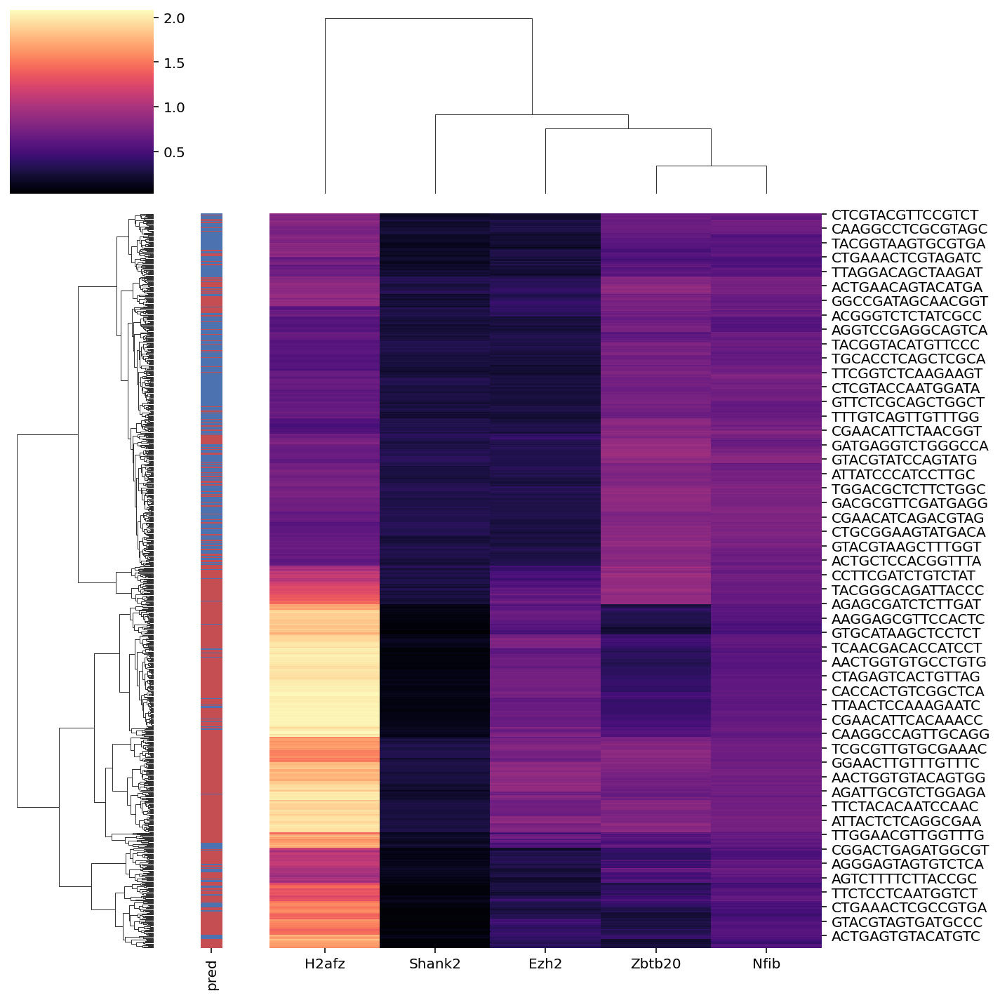

In [164]:
#it is pretty evident that Ezh2 and Kdm5b are the TFs with most impact in Cdk1
heatmap_df = ductal_im[[gene] + list(temp['index'][:4])]
species = gene_df_ductal['pred']
lut = dict(zip(species.unique(), "rbg"))
row_colors = species.map(lut)
sns.clustermap(heatmap_df, cmap="magma", row_colors=row_colors)
plt.savefig('./figures/Shank2_heatmap_imputed.jpg')

saving figure to file ./figures/scvelo_ductal_shank2.png


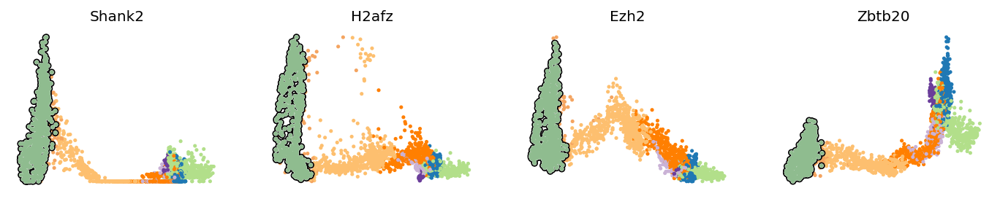

In [167]:
scv.pl.scatter(oracle.adata, x='latent_time', y=['Shank2','H2afz','Ezh2','Zbtb20'], add_outline = 'Ductal', frameon=False, save = 'ductal_shank2.png')

saving figure to file ./figures/scvelo_ductal_trajectory_shank2.png


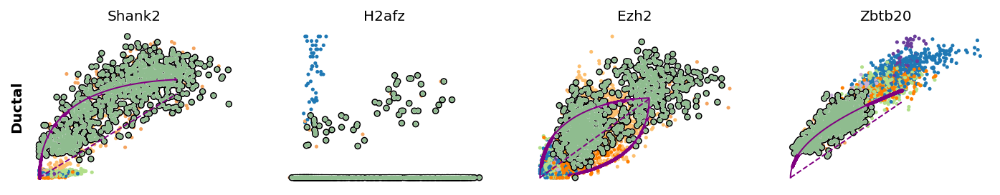

In [169]:
scv.pl.scatter(oracle.adata, ['Shank2','H2afz','Ezh2','Zbtb20'], ylabel='Ductal', add_outline = 'Ductal', frameon=False, save='ductal_trajectory_shank2.png')

Why a lot of the grn-displacements are zero? Is just that they do not have enough variance, they are not significant.

In [184]:
#load GRNs, which were saved in the Links obect
links = co.load_hdf5("./links.celloracle.links")

In [185]:
high_shank2_coefs = pd.DataFrame(oracle.coef_matrix_per_cluster['Ngn3 high EP']['Shank2'][oracle.coef_matrix_per_cluster['Ngn3 high EP']['Shank2']!=0]).reset_index()
high_shank2_coefs

,index,Shank2
0,Shank2,1.0


In [186]:
high_shank2_coefs_orig = links.links_dict['Ngn3 high EP'][links.links_dict['Ngn3 high EP']['target']=='Shank2']
high_shank2_coefs_orig.sort_values(by='p', ascending=False)
#simply, none of the predictors are significant.

,source,target,coef_mean,coef_abs,p,-logp
110360,Clock,Shank2,0.000022,0.000022,9.146115e-01,0.038763
110341,Mef2a,Shank2,0.000180,0.000180,5.279451e-01,0.277411
110354,Hivep1,Shank2,0.000194,0.000194,4.814055e-01,0.317489
110345,Meis2,Shank2,-0.000124,0.000124,4.378359e-01,0.358689
110312,Hnf1b,Shank2,-0.000315,0.000315,4.235916e-01,0.373053
...,...,...,...,...,...,...
110330,Nkx6-1,Shank2,-0.005902,0.005902,2.309695e-13,12.636445
110356,Isl1,Shank2,-0.003058,0.003058,1.864594e-13,12.729416
110383,Tcf7l2,Shank2,0.005804,0.005804,5.701227e-14,13.244032
110401,Zfp467,Shank2,0.007203,0.007203,2.910382e-14,13.536050


### Genes same direction

saving figure to file ./figures/scvelo_right_velocity.png


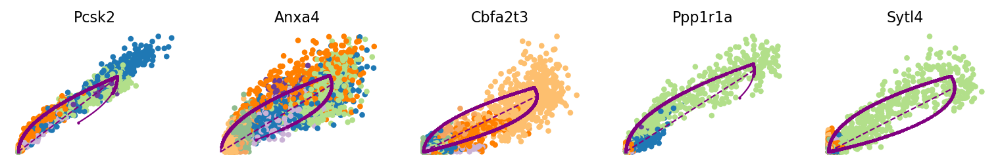

saving figure to file ./figures/scvelo_right_time.png


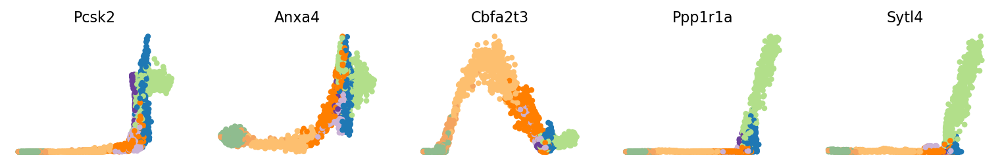

In [187]:
var_names = ['Pcsk2', 'Anxa4', 'Cbfa2t3', 'Ppp1r1a', 'Sytl4']
scv.pl.scatter(top30, var_names, frameon=False, size= 60, dpi = 150, save='right_velocity.png')
scv.pl.scatter(top30, x='latent_time', y=var_names, frameon=False, size= 60, dpi=150, save='right_time.png')

In [188]:
indices = np.asarray(top30_corr.index[top30_corr['gene'].isin(var_names)])

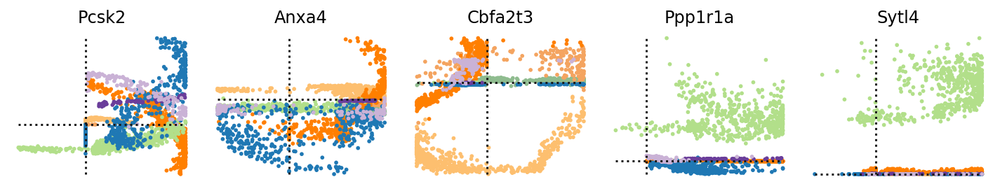

In [189]:
fig, axs = plt.subplots(1, 5, figsize=(10,2),constrained_layout=True)

for i,var in enumerate(var_names):
    j=indices[i]
    sc.pl.scatter(top30, x=var, y=var, layers=('velocity','grn','velocity'), color='clusters',show=False, ax=axs[i])
    axs[i].set_title(var)
    axs[i].set_xlabel('velocity')
    axs[i].set_ylabel('grn')
    axs[i].get_legend().remove()
    axs[i].axis('off')
    min_vel = min(np.transpose(top30.layers['velocity'])[j])
    max_vel = max(np.transpose(top30.layers['velocity'])[j])
    min_grn = min(np.transpose(top30.layers['grn'])[j])
    max_grn = max(np.transpose(top30.layers['grn'])[j])
    axs[i].plot([0,0],[min_grn,max_grn], 'k:')
    axs[i].plot([min_vel,max_vel],[0,0], 'k:')

plt.savefig("./figures/top30_grn_same.png", dpi=150)

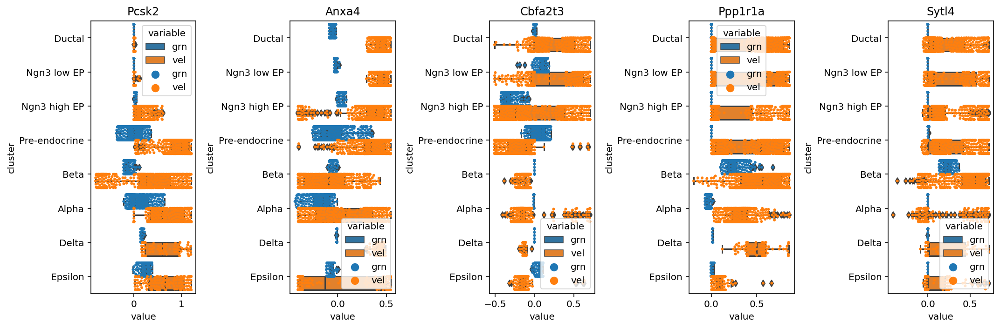

In [190]:
f, axs = plt.subplots(1,5,figsize=(15,5))

for i,var in enumerate(var_names):
    var_df = top30_grn_vel_df_melt[top30_grn_vel_df_melt.gene == var]
    axs[i] = sns.swarmplot(y="cluster", x='value', data=var_df, hue='variable', order=order, dodge=True, orient='h', size=3, ax=axs[i])
    axs[i] = sns.boxplot(y="cluster", x='value', data=var_df, hue='variable', order=order, orient='h', ax=axs[i])
    axs[i].set_title(var)
    #axs[i].set_xticklabels(labels=order, rotation=90)
plt.savefig("./figures/right_grn_vel.jpg")

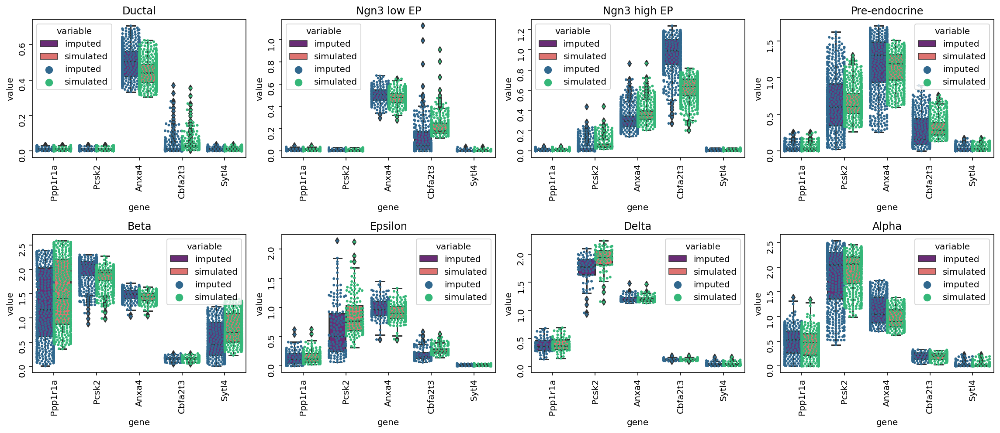

In [191]:
f, axs = plt.subplots(2,4,figsize=(16,7))

for i,clus in enumerate(order):
    if i <4:
        j=0
        k=i
    else:
        j=1
        k=4-i
    var_df = gem_df_melt[gem_df_melt.cluster == clus][gem_df_melt['gene'].isin(var_names)]
    sns.swarmplot(x="gene", y='value', data=var_df, hue='variable', dodge=True, orient='v', size=3, ax=axs[j,k], palette='viridis')
    sns.boxplot(x="gene", y='value', data=var_df, hue='variable', orient='v', ax=axs[j,k], palette='magma')
    axs[j,k].set_title(clus)
    axs[j,k].tick_params(labelrotation=90)
plt.savefig("./figures/right_grn_ex.jpg")

In [192]:
#by their behaviour, we can divide the genes in two sets:
set1 = ['Ppp1r1a', 'Sytl4']

In [193]:
#lets see if they have TFs in common
coefs_beta_set1 = oracle.coef_matrix_per_cluster['Beta'][set1]
coefs_beta_set1 = coefs_beta_set1[(coefs_beta_set1.T != 0).any()]
coefs_beta_set1['max_abs'] = coefs_beta_set1.abs().max(axis=1)
coefs_beta_set1=coefs_beta_set1.sort_values(by='max_abs', ascending=False)
coefs_beta_set1 = coefs_beta_set1.drop('max_abs', axis=1)
coefs_beta_set1['gene']=coefs_beta_set1.index
coefs_beta_set1_melt = coefs_beta_set1.melt(value_vars = set1, id_vars=['gene'])

In [194]:
sns.set_style('whitegrid')

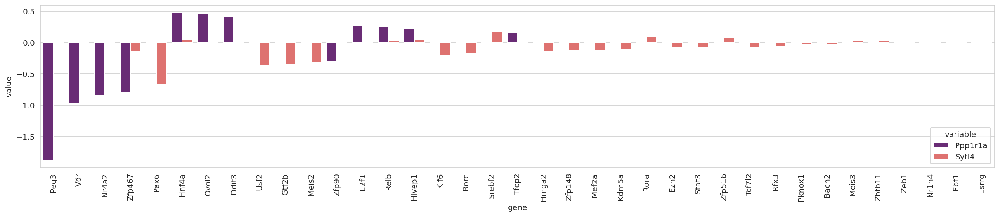

In [195]:
plt.figure(figsize=(18,4))
sns.barplot(x='gene', y='value', hue='variable', data = coefs_beta_set1_melt, palette='magma')
plt.xticks(rotation=90)
plt.savefig("./figures/wrong_coefs_beta_set1.jpg")

In [196]:
sns.reset_orig()
rcParams.update({'figure.autolayout': True})

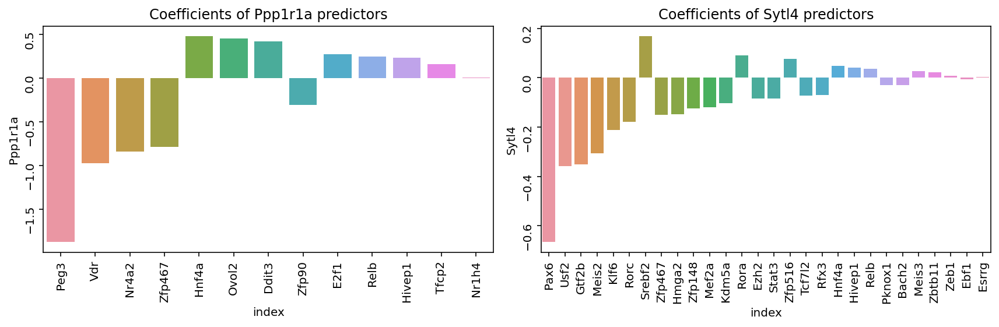

In [201]:
#coefficients for genes in Set1
f, axs = plt.subplots(1,2, figsize=(12,4))

for i, gene in enumerate(set1):
    temp = oracle.coef_matrix_per_cluster['Beta'][gene]
    temp = pd.DataFrame(temp[temp!=0]).reset_index()
    temp['abs'] = np.abs(temp[gene])
    temp = temp.sort_values(by='abs', ascending=False)
    sns.barplot(data=temp, x='index', y=gene, ax=axs[i])
    axs[i].tick_params(labelrotation=90)
    axs[i].set_title('Coefficients of ' + str(gene) + ' predictors' )
plt.savefig("./figures/right_set1_coefs.jpg")

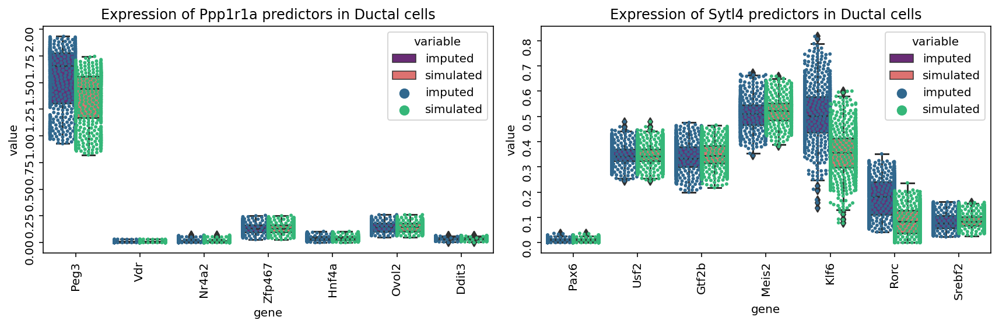

In [202]:
f, axs = plt.subplots(1,2, figsize=(12,4))

for i, gene in enumerate(set1):
    temp = oracle.coef_matrix_per_cluster['Beta'][gene]
    temp = pd.DataFrame(temp[temp!=0]).reset_index()
    temp['abs'] = np.abs(temp[gene])
    temp = temp.sort_values(by='abs', ascending=False)
    var_df = gem_df_melt[gem_df_melt.cluster == 'Ductal'][gem_df_melt['gene'].isin(temp['index'][:7])]
    sns.swarmplot(x="gene", y='value', data=var_df, hue='variable', dodge=True, orient='v', size=3, palette='viridis', order=temp['index'][:7], ax = axs[i])
    sns.boxplot(x="gene", y='value', data=var_df, hue='variable', orient='v', palette='magma', order=temp['index'][:7], ax=axs[i])
    axs[i].tick_params(labelrotation=90)
    axs[i].set_title('Expression of ' + str(gene) + ' predictors in Ductal cells' )
plt.savefig("./figures/right_set1_TFs_expression.jpg")

saving figure to file ./figures/scvelo_beta_ppp.png


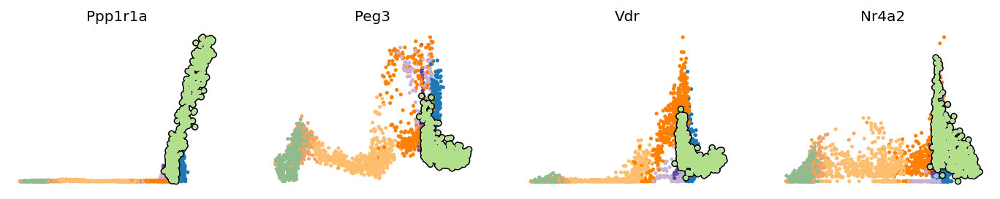

In [199]:
scv.pl.scatter(oracle.adata, x='latent_time', y=['Ppp1r1a','Peg3','Vdr','Nr4a2'], add_outline = 'Beta', frameon=False, save = 'beta_ppp.png')

saving figure to file ./figures/scvelo_beta_trajectory_ppp.png


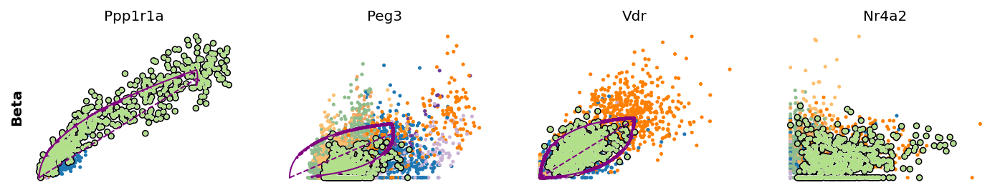

In [200]:
scv.pl.scatter(oracle.adata, ['Ppp1r1a','Peg3','Vdr','Nr4a2'], ylabel='Beta', add_outline = 'Beta', frameon=False, save='beta_trajectory_ppp.png')